#### GRÁFICOS
* A continuación se presentan las imágenes y métricas de la red para todos los períodos de 5 años en que Chile aparece con programas de gobierno (Período 14 (1985 a 1989) al Período 21 (2020 a 2024))
* La similaridad es según la correlación entre programas de gobierno
* Se usó un umbral de correlaciones >= 0.80 para construir la red, identificar comunidades y pàra calcular las métricas de centralidad. 
* Para la identificación de comunidades también se consideró un umbral de 0.60.
* Para poder comparar la visualización se presenta la m,isma información de dos maneras: La primera es de a pares de gráficos y la  segunda es gráficos individuales.

#### Períodos

In [1]:
import pandas as pd
df_ventana_5 = pd.read_excel('data/Ventana_5.xlsx')
df_resultado = df_ventana_5.groupby('ventana')['agno'].agg(Desde='min', Hasta='max').reset_index()
df_resultado = df_resultado[df_resultado['ventana'] >= 14]
print(df_resultado.to_string(index=False))


 ventana  Desde  Hasta
      14   1985   1989
      15   1990   1994
      16   1995   1999
      17   2000   2004
      18   2005   2009
      19   2010   2014
      20   2015   2019
      21   2020   2023


### Visualización De a pares

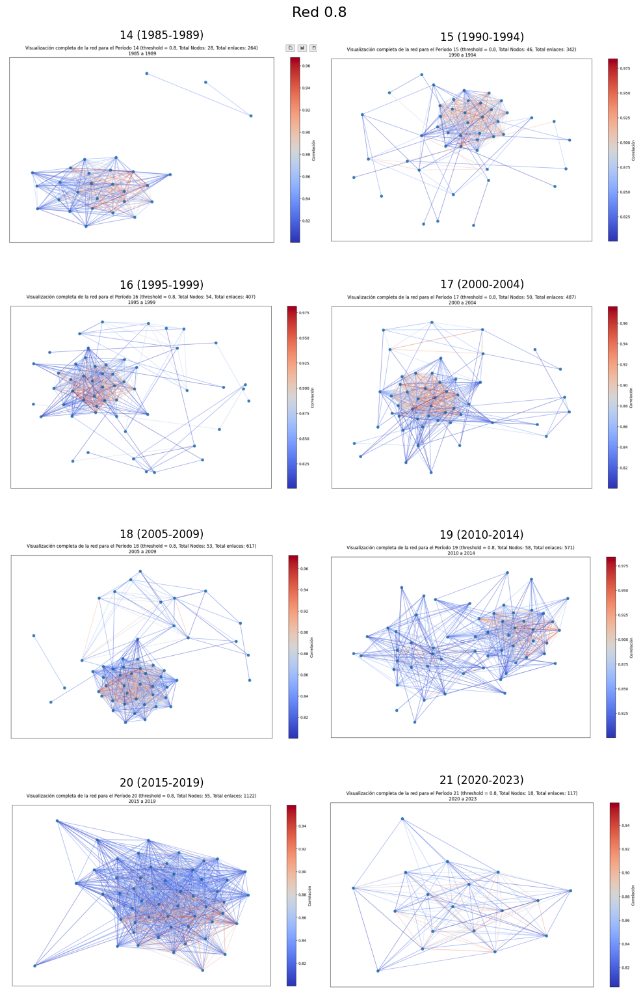

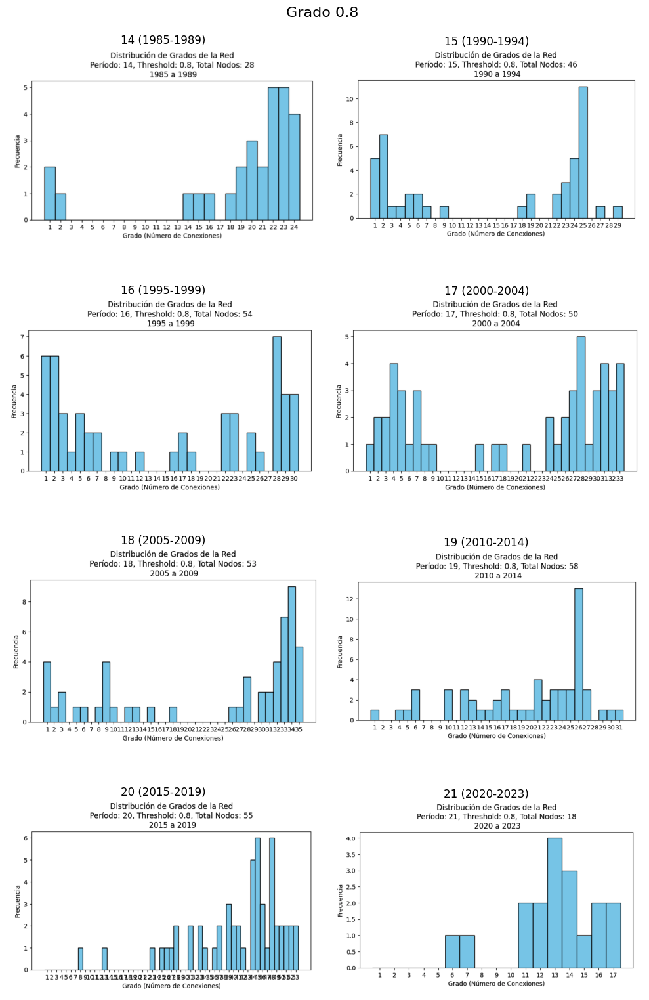

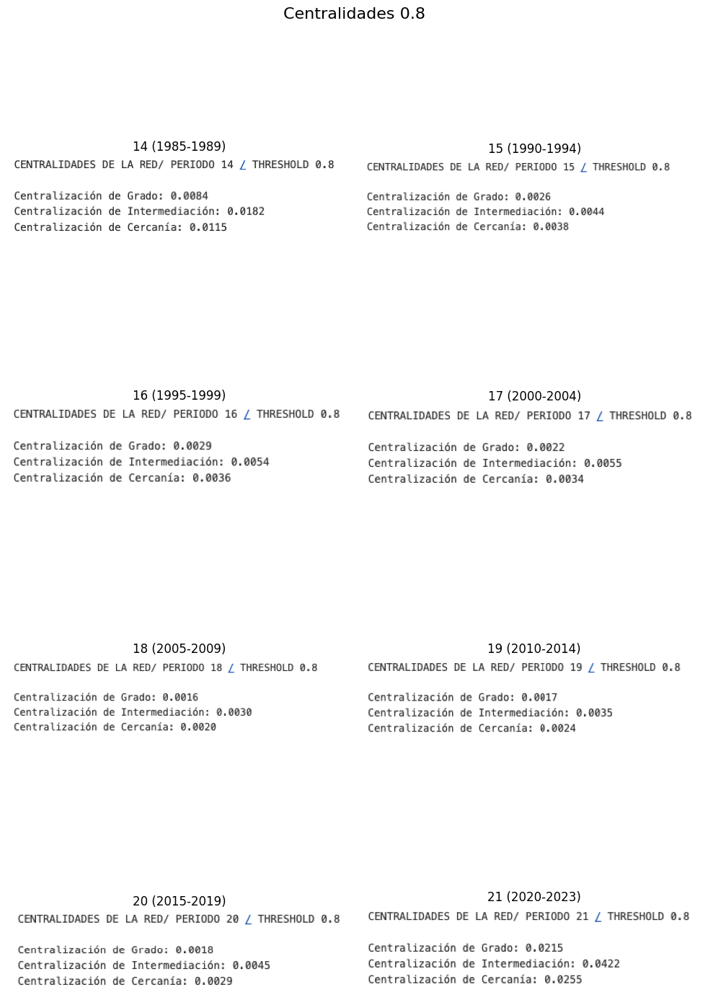

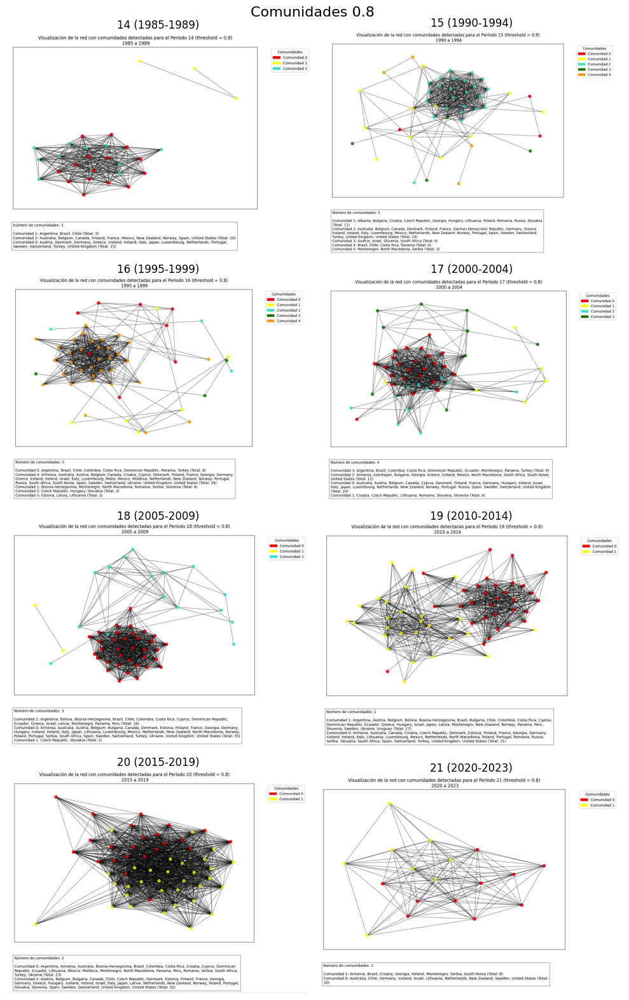

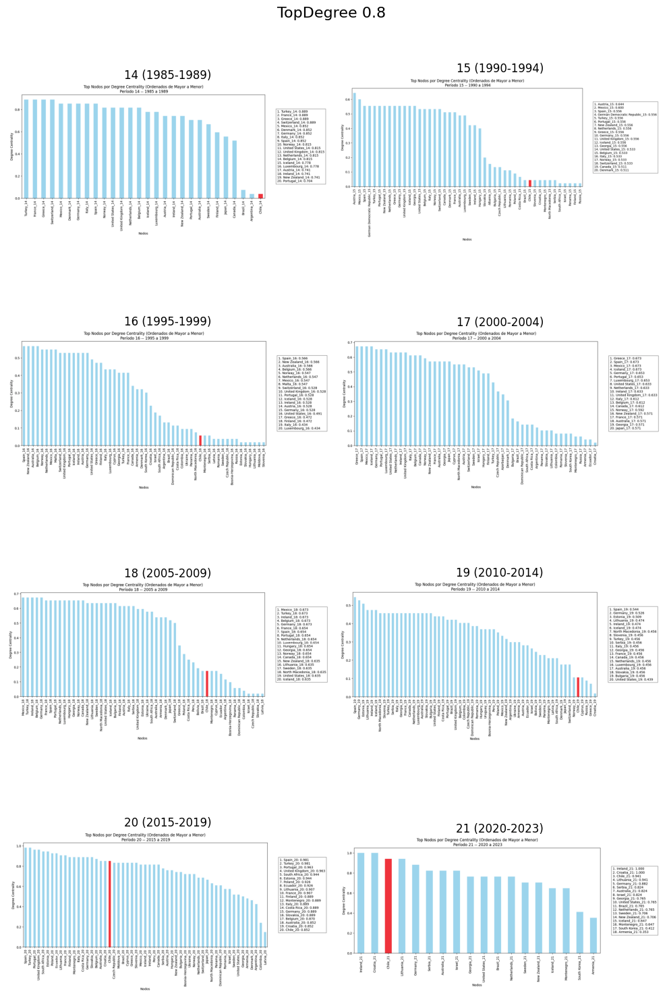

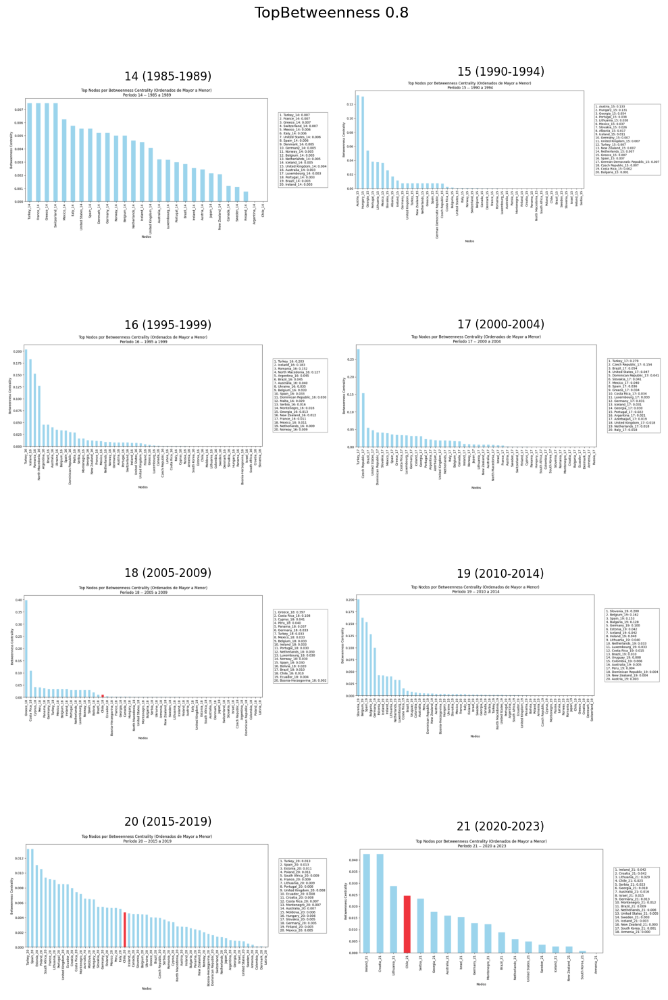

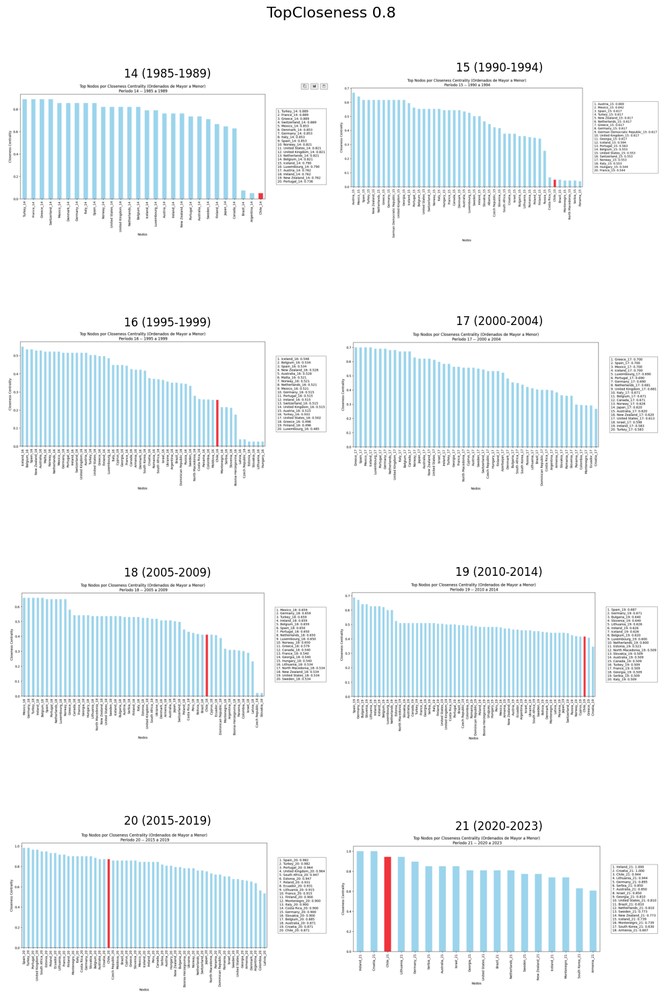

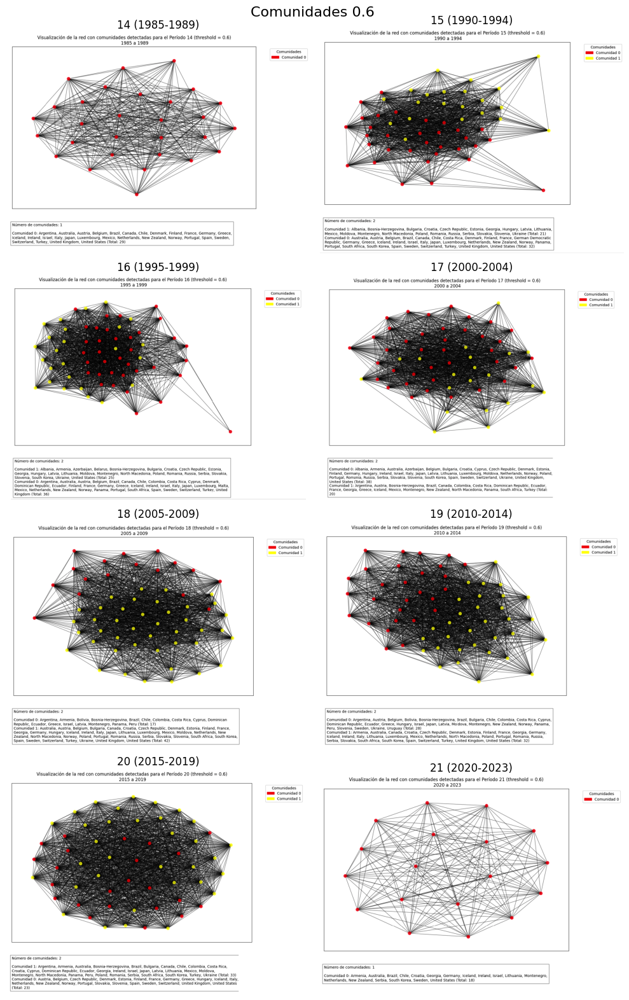

In [2]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd

# Cargar el archivo Excel y preparar el DataFrame
df_ventana_5 = pd.read_excel('data/Ventana_5.xlsx')
df_resultado = df_ventana_5.groupby('ventana')['agno'].agg(Desde='min', Hasta='max').reset_index()
df_resultado = df_resultado[df_resultado['ventana'] >= 14]

# Convertir 'ventana' en índice para acceder fácilmente a los valores 'Desde' y 'Hasta'
df_resultado.set_index('ventana', inplace=True)

# Ruta del directorio 'assets' (un nivel arriba del directorio actual)
assets_dir = '../assets'

# Listado de los tipos de imágenes
tipos_imagenes = [
    'Red 0.8 ', 'Grado 0.8 ', 'Centralidades 0.8 ', 'Comunidades 0.8 ',
    'TopDegree 0.8 ', 'TopBetweenness 0.8 ', 'TopCloseness 0.8 ', 'Comunidades 0.6 '
]

# Números que van de 14 a 21 (ventanas que queremos graficar)
numeros = range(14, 22)

# Tamaño base de las figuras (ajustable según el número de imágenes)
width_per_col = 5  # Ancho por columna en pulgadas
height_per_row = 4  # Alto por fila en pulgadas

for tipo in tipos_imagenes:
    # Calcular el tamaño de la figura según el número de filas y columnas
    n_cols = 2  # Número de columnas (2 imágenes por fila)
    n_rows = (len(numeros) + 1) // n_cols  # Calcula el número de filas necesario
    figsize = (width_per_col * n_cols, height_per_row * n_rows)  # Tamaño de la figura
    
    # Crear una nueva figura para cada tipo de imagen con el tamaño calculado
    fig, axs = plt.subplots(n_rows, n_cols, figsize=figsize)
    fig.suptitle(tipo, fontsize=16)
    
    for i, num in enumerate(numeros):
        # Calcular la posición en la grilla
        row, col = divmod(i, n_cols)
        
        # Construir el nombre del archivo de imagen
        image_name = f"{tipo.split()[0]} {num} {tipo.split()[1]}.png"
        image_path = os.path.join(assets_dir, image_name)
        
        # Cargar la imagen y mostrarla en el subplot correspondiente
        img = Image.open(image_path)
        axs[row, col].imshow(img)
        axs[row, col].axis('off')
        
        # Obtener los valores 'Desde' y 'Hasta' para la ventana actual
        desde_hasta = f"{df_resultado.at[num, 'Desde']}-{df_resultado.at[num, 'Hasta']}"
        
        # Mostrar el título con 'ventana' y 'Desde-Hasta'
        axs[row, col].set_title(f"{num} ({desde_hasta})", fontsize=12)
    
    # Desactivar los ejes de las celdas vacías
    for j in range(len(numeros), n_rows * n_cols):
        row, col = divmod(j, n_cols)
        axs[row, col].axis('off')
    
    plt.tight_layout()
    plt.show()


### Gráficos de a uno

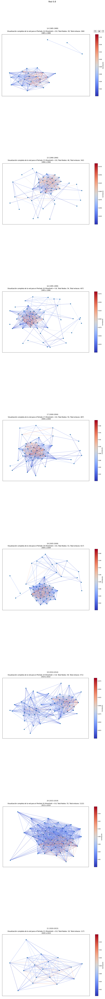

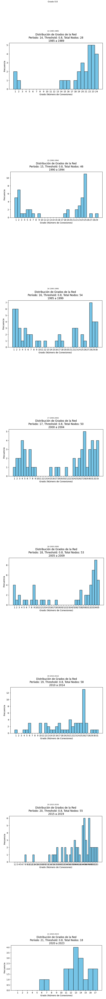

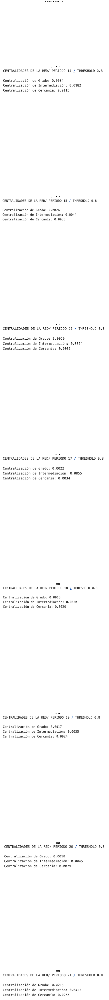

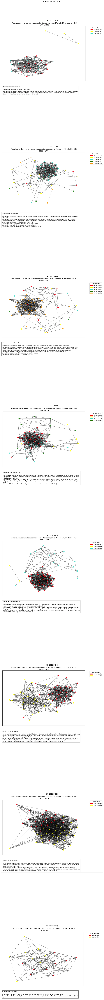

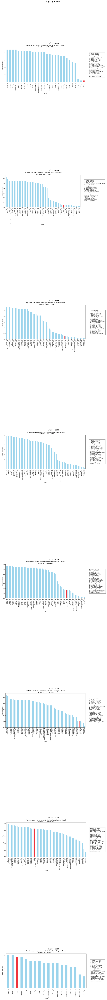

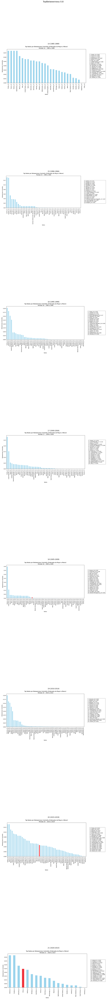

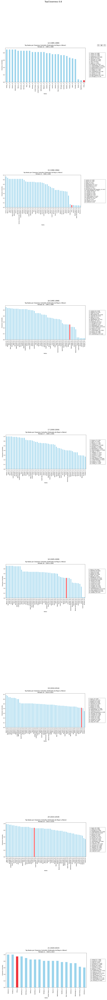

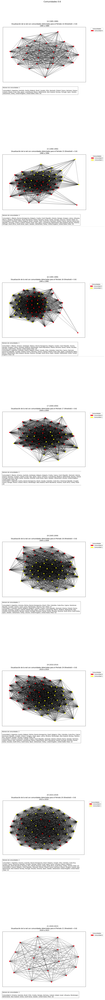

In [3]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd

# Cargar el archivo Excel y preparar el DataFrame
df_ventana_5 = pd.read_excel('data/Ventana_5.xlsx')
df_resultado = df_ventana_5.groupby('ventana')['agno'].agg(Desde='min', Hasta='max').reset_index()
df_resultado = df_resultado[df_resultado['ventana'] >= 14]

# Convertir 'ventana' en índice para acceder fácilmente a los valores 'Desde' y 'Hasta'
df_resultado.set_index('ventana', inplace=True)

# Ruta del directorio 'assets' (un nivel arriba del directorio actual)
assets_dir = '../assets'

# Listado de los tipos de imágenes
tipos_imagenes = [
    'Red 0.8 ', 'Grado 0.8 ', 'Centralidades 0.8 ', 'Comunidades 0.8 ',
    'TopDegree 0.8 ', 'TopBetweenness 0.8 ', 'TopCloseness 0.8 ', 'Comunidades 0.6 '
]

# Números que van de 14 a 21 (ventanas que queremos graficar)
numeros = range(14, 22)

# Parámetro ajustable para la altura de cada imagen
height_per_image = 15  # Ajusta este valor para cambiar la altura de cada imagen en la figura

for tipo in tipos_imagenes:
    # Configuración del tamaño de la figura en función de la cantidad de imágenes y la altura por imagen
    figsize = (12, height_per_image * len(numeros))  # Ancho fijo, altura variable
    
    # Crear una nueva figura para cada tipo de imagen con el tamaño calculado
    fig, axs = plt.subplots(len(numeros), 1, figsize=figsize)
    fig.suptitle(tipo, fontsize=16)
    
    for i, num in enumerate(numeros):
        # Construir el nombre del archivo de imagen
        image_name = f"{tipo.split()[0]} {num} {tipo.split()[1]}.png"
        image_path = os.path.join(assets_dir, image_name)
        
        # Cargar la imagen y mostrarla en el subplot correspondiente
        img = Image.open(image_path)
        axs[i].imshow(img)
        axs[i].axis('off')
        
        # Obtener los valores 'Desde' y 'Hasta' para la ventana actual
        desde_hasta = f"{df_resultado.at[num, 'Desde']}-{df_resultado.at[num, 'Hasta']}"
        
        # Mostrar el título con 'ventana' y 'Desde-Hasta'
        axs[i].set_title(f"{num} ({desde_hasta})", fontsize=12)
    
    plt.tight_layout()
    plt.show()
